In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import astropy.units
from astropy import constants as const
import collections, numpy
import matplotlib.lines as mlines
import matplotlib.cm as cm
from matplotlib.lines import Line2D
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                             AutoMinorLocator)
from scipy.stats import linregress
import sys
import math as ma
from numpy import inf
import numpy as np
import time
from matplotlib.pyplot import figure as fig
from scipy import stats
from scipy.stats import norm



In [2]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import astropy.units
from astropy import constants as const
import collections, numpy
import matplotlib.lines as mlines
import matplotlib.cm as cm
from matplotlib.lines import Line2D
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                             AutoMinorLocator)
from astropy.io import ascii
from astropy import table
from astropy.table import unique, Table, hstack, Column
import sys
from numpy import inf
import numpy as np
import time
from matplotlib.pyplot import figure as fig
from scipy import stats
from scipy.stats import norm



In [8]:
#Defining Variables and constants

Big_M = (1e8 * const.M_sun.value) #kg
Obj_Radius = 0.1 * const.au.value # m
small_m = const.M_sun.value #kg
vi = 2e9 #m/s 
xi = 4*const.au.value #m
ymax = const.au.value/2  #m
#ypos=np.linspace(0,1,int(N)+1)[1:]*(ymax)


    
dt = 10 # second time step
N = 50 #Number of steps 


colors = mpl.cm.get_cmap()(np.linspace(0.0, 1.0, int(N))) # setting colors for data pts


escape_vel= np.sqrt(2*const.G.value * Big_M/xi)
print(f"escape velocity = {escape_vel/1e5:.4e}")
escape_time = xi/(escape_vel * vi)
#print(f"escape time = {time:.4e}")
dt,ymax

escape velocity = 2.1061e+03


(10, 74798935350.0)

In [10]:
#defining my motion functions in order to place inside leapfrog function for loop
def Position(x,vx,ax,dt):
    x = x + vx * dt + 0.5*(ax)*dt**2
    return x

def Acceleration(xpos,ypos):
    a = ((-const.G.value*Big_M/((xpos**2+ypos**2)**(3/2))))
    A = (a*(small_m/Big_M))
    return a, A

def Velocity(vx,ax,ax_1,dt):
    vx = vx + 0.5*(ax + ax_1)*dt
    return vx
    
#def Force(xpos,ypos):
#    F_s = ((-const.G.value*Big_M*small_m)/((xpos**2+ypos**2)**(3/2)))
#    return F_s

In [11]:
#Leapfrog for 10 particle DUPLICATE not using second for loop and using a functio for the entire calculation.
#For calculation of positions, velocities, and accelerations of the smaller mass particles. 
def leapfrog(xi,ymax,vi,N,P,dt):

    x = np.ones(P)*xi
    y = np.linspace(0,1,int(P)+1)[1:]*(ymax)
    vx = np.ones(P)*(-vi)
    vy = np.zeros(P)


    Xpos=np.zeros((P,N))
    Ypos=np.zeros((P,N))
    Xvel=np.zeros((P,N))
    Yvel=np.zeros((P,N))
    Xacc=np.zeros((P,N))
    Yacc=np.zeros((P,N))
    
    #Xpos=np.zeros((N))
    #Ypos=np.zeros((N))
    XvelB=np.zeros((N))
    YvelB=np.zeros((N))
    XaccB=np.zeros((N))
    YaccB=np.zeros((N))

    Xpos[:,0]=x
    Ypos[:,0]=y
    Xvel[:,0]=vx
    Yvel[:,0]=vy
    Xacc[:,0]=((-const.G.value*Big_M/((Xpos[:,0]**2+Ypos[:,0]**2)**(3/2)))*Xpos[:,0])
    Yacc[:,0]=((-const.G.value*Big_M/((Xpos[:,0]**2+Ypos[:,0]**2)**(3/2)))*Ypos[:,0])
    for i in range(N-1):
        #for j in range(p):

        Xpos[:,i+1] = Position(Xpos[:,i],Xvel[:,i],Xacc[:,i],dt)
            #Xpos[j,i+1] = Xpos[j,i] + Xvel[j,i] *dt + 0.5*(Xacc[j,i])*dt**2 
        Ypos[:,i+1] = Position(Ypos[:,i],Yvel[:,i],Yacc[:,i],dt) 

        #The x pos at this point is giving iterating up to N=1

        Acc, AccB = Acceleration(Xpos[:,i+1],Ypos[:,i+1]) 
        Xacc[:,i+1] = Acc*Xpos[:,i+1]
        Yacc[:,i+1] = Acc*Ypos[:,i+1]
        XaccB[i+1] = np.sum(AccB*(-Xpos[:,i+1]))
        YaccB[i+1] = np.sum(AccB*(-Ypos[:,i+1]))

        Xvel[:,i+1] = Velocity(Xvel[:,i],Xacc[:,i],Xacc[:,i+1],dt)
        Yvel[:,i+1] = Velocity(Yvel[:,i],Yacc[:,i],Yacc[:,i+1],dt)
        #integrate velocities for massive object. Still make arrays over time
        
    return Xpos, Ypos, Xvel, Yvel, Xacc, Yacc, XaccB, YaccB
    


In [12]:
Xpos, Ypos, Xvel, Yvel, Xacc, Yacc, XaccB, YaccB = leapfrog(xi,ymax,vi,N,10,dt)


/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


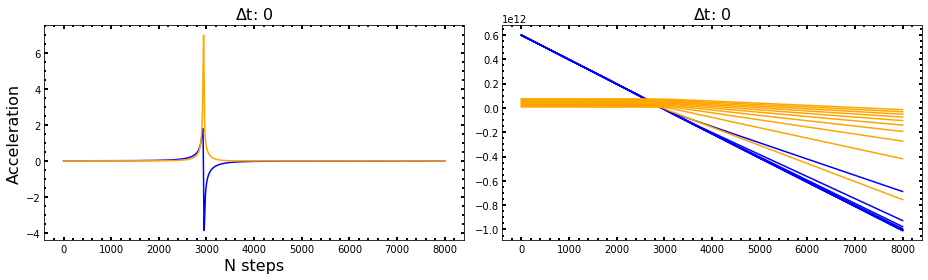

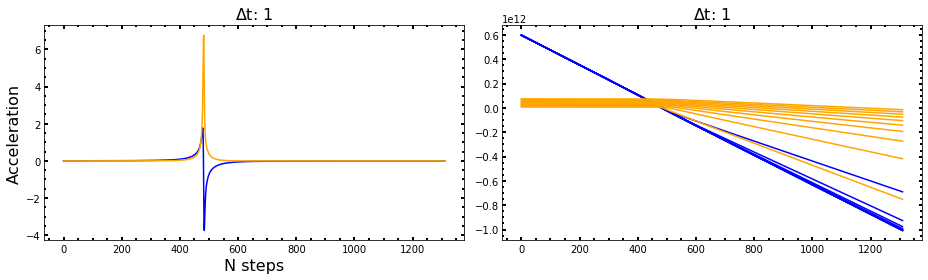

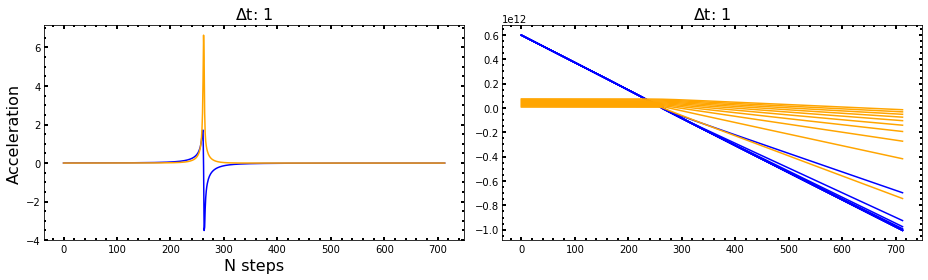

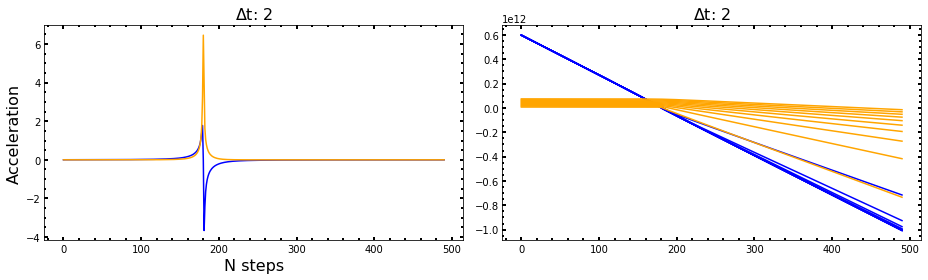

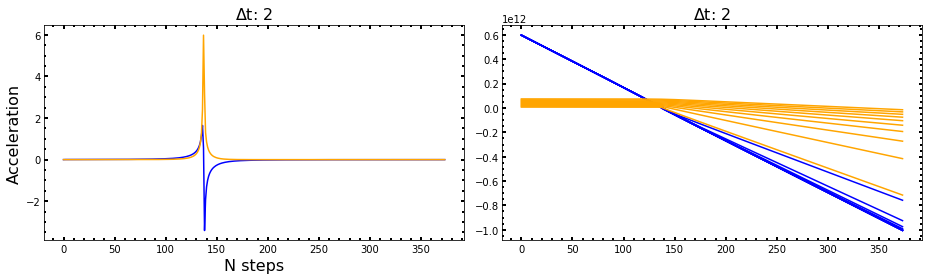

...

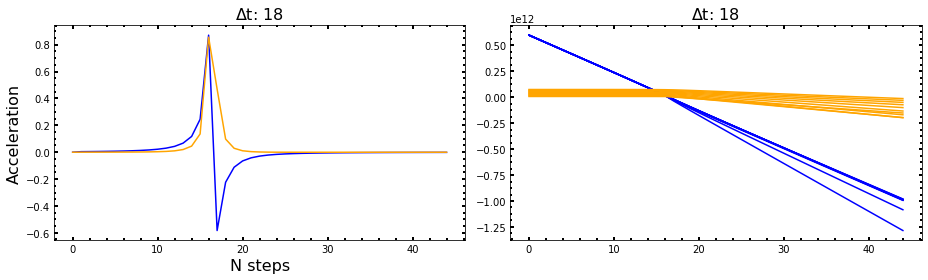

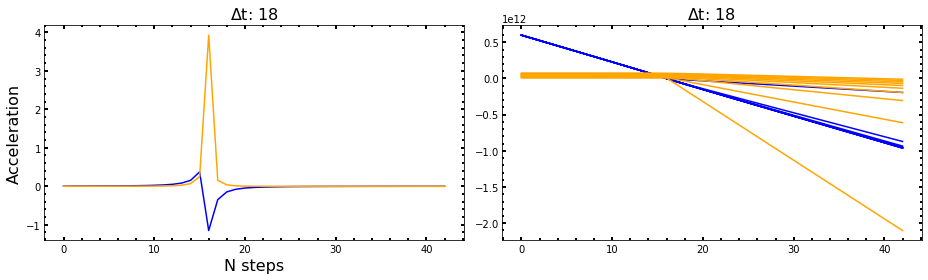

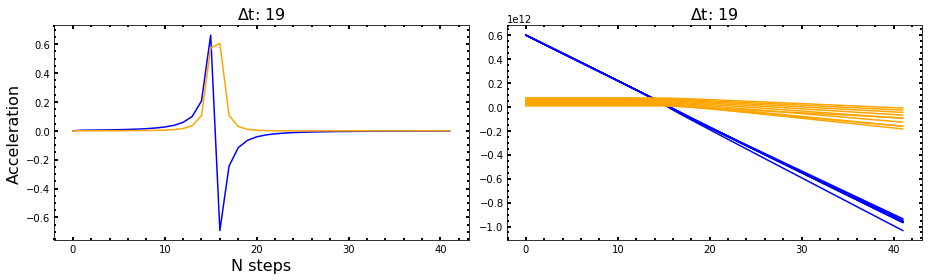

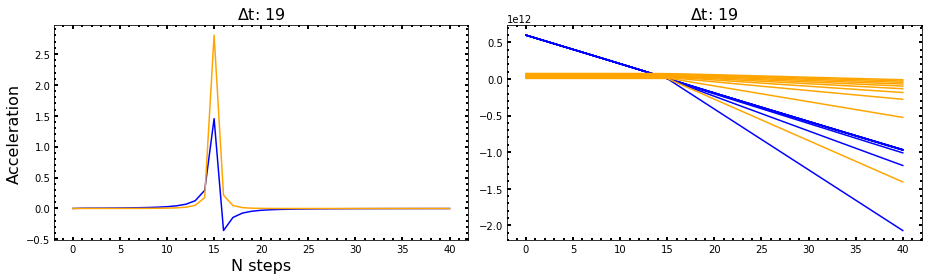

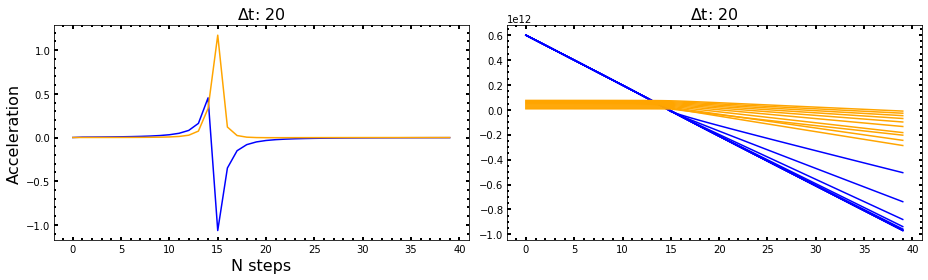

In [13]:
dts=np.linspace(0.1,20,40) #array of dts
time=800 #variable for how long the simulation will run for 
P=10

for i in range(len(dts)):
    Nsteps=time/dts[i]
    Nsteps=int(np.round(Nsteps))
    Xpos, Ypos, Xvel, Yvel, Xacc, Yacc, XaccB, YaccB = leapfrog(xi,ymax,vi,Nsteps,P,dts[i])
    

    #xpos_e,ypos_e,xvel_e,yvel_e,xacc_e,yacc_e=euler(xi,ymax,vi,Nsteps,10,dts[i])
    #print(xpos)
    fig, ax = plt.subplots(1,2,figsize=(13,4))
    ax[0].plot(XaccB,color='blue', label='X-Acceleration')
    ax[0].plot(YaccB, color='orange',label='Y-Acceleration')
    ax[0].set_xlabel('N steps',fontsize=16)
    ax[0].set_ylabel('Acceleration',fontsize=16)
    ax[0].tick_params(which='both', direction='in',width=2)
    ax[0].yaxis.set_minor_locator(AutoMinorLocator())
    ax[0].xaxis.set_minor_locator(AutoMinorLocator())
    ax[0].yaxis.set_ticks_position('both')
    ax[0].xaxis.set_ticks_position('both')
    ax[0].set_title('$\Delta$t: {:d}'.
             format(int(np.round(dts[i]))),fontsize=16)
    
    ax[1].plot(Xpos[:].T,color='blue')
    ax[1].plot(Ypos[:].T,color='orange')
    #ax[1].set_xlabel('X Position',fontsize=16)
    #ax[1].set_ylabel('Y Position',fontsize=16)
    ax[1].tick_params(which='both', direction='in',width=2)
    ax[1].yaxis.set_minor_locator(AutoMinorLocator())
    ax[1].xaxis.set_minor_locator(AutoMinorLocator())
    ax[1].yaxis.set_ticks_position('both')
    ax[1].xaxis.set_ticks_position('both')
    ax[1].set_title('$\Delta$t: {:d}'.
             format(int(np.round(dts[i]))),fontsize=16)
    
    

    plt.tight_layout()

    #plt.legend(fontsize=16)
    #plt.text(8000,.6e12,'$\Delta$t: {:d}'.
             #format(int(np.round(dts[i]))),horizontalalignment='center',bbox={'facecolor':'w'},fontsize=13)


    
    


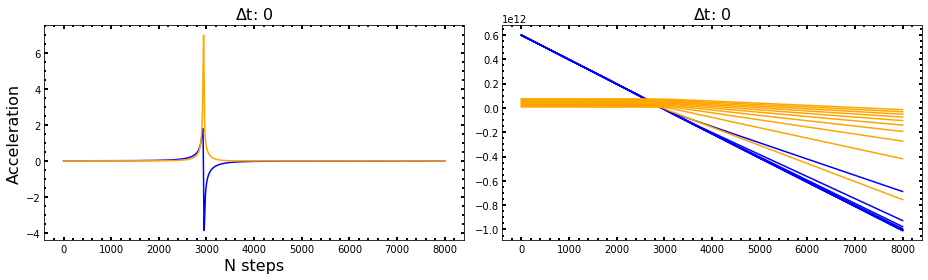

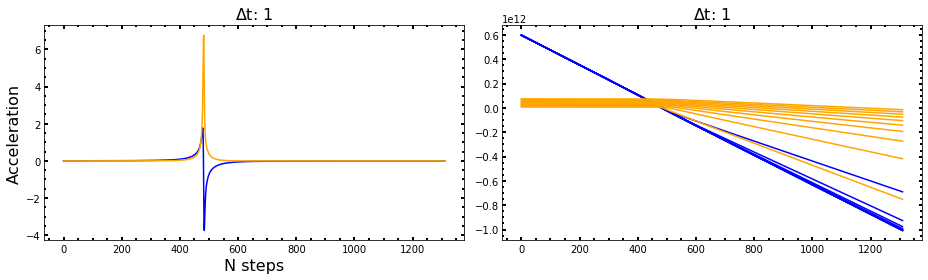

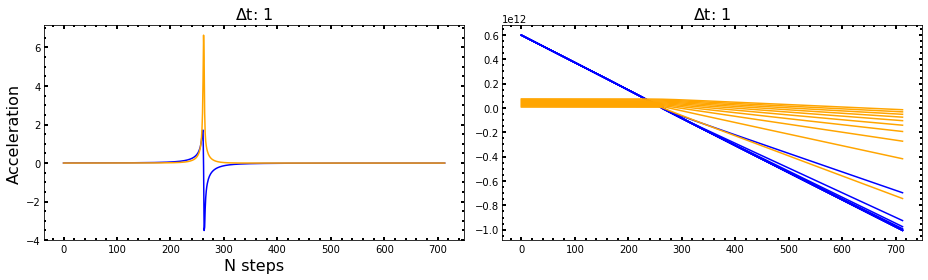

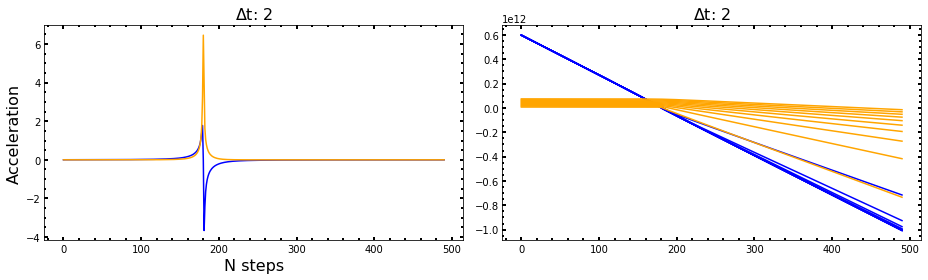

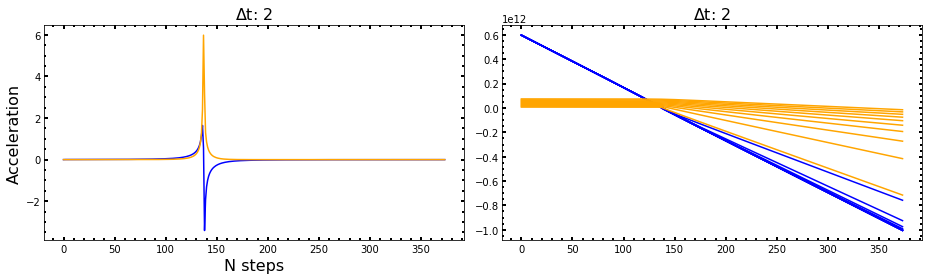

...

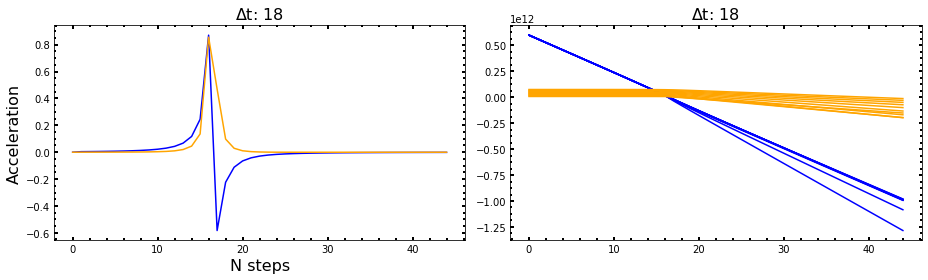

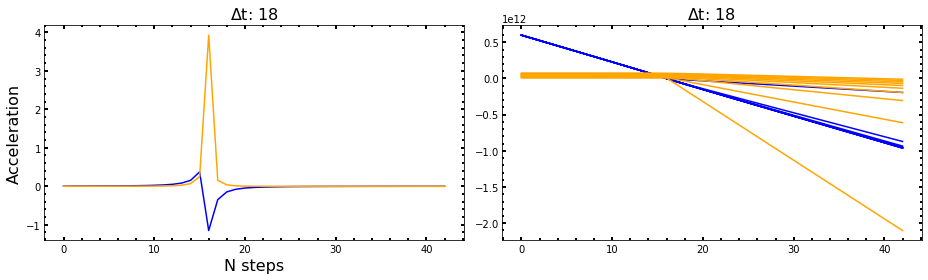

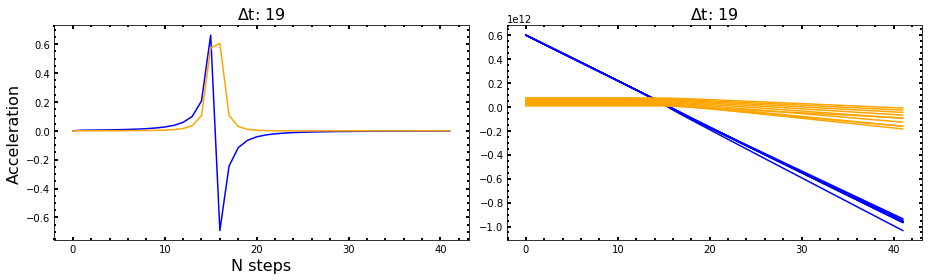

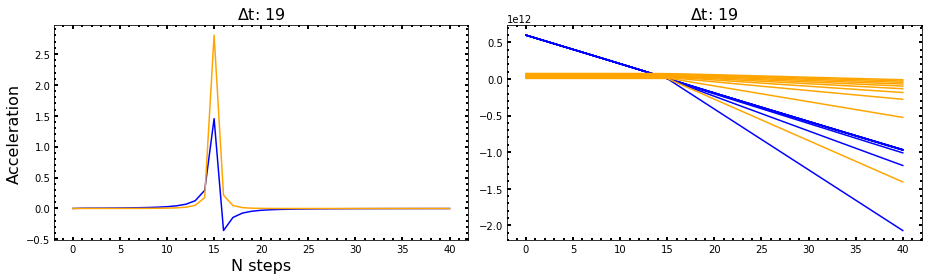

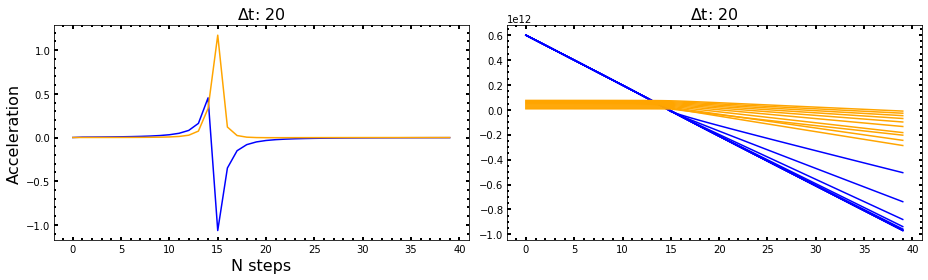

In [14]:
dts=np.linspace(0.1,20,40) #array of dts
time=800 #variable for how long the simulation will run for 
P=10

for i in range(len(dts)):
    Nsteps=time/dts[i]
    Nsteps=int(np.round(Nsteps))
    Xpos, Ypos, Xvel, Yvel, Xacc, Yacc, XaccB, YaccB = leapfrog(xi,ymax,vi,Nsteps,P,dts[i])
    

    #xpos_e,ypos_e,xvel_e,yvel_e,xacc_e,yacc_e=euler(xi,ymax,vi,Nsteps,10,dts[i])
    #print(xpos)
    fig, ax = plt.subplots(1,2,figsize=(13,4))
    ax[0].plot(XaccB,color='blue', label='X-Acceleration')
    ax[0].plot(YaccB, color='orange',label='Y-Acceleration')
    ax[0].set_xlabel('N steps',fontsize=16)
    ax[0].set_ylabel('Acceleration',fontsize=16)
    ax[0].tick_params(which='both', direction='in',width=2)
    ax[0].yaxis.set_minor_locator(AutoMinorLocator())
    ax[0].xaxis.set_minor_locator(AutoMinorLocator())
    ax[0].yaxis.set_ticks_position('both')
    ax[0].xaxis.set_ticks_position('both')
    ax[0].set_title('$\Delta$t: {:d}'.
             format(int(np.round(dts[i]))),fontsize=16)
    
    ax[1].plot(Xpos[:].T,color='blue')
    ax[1].plot(Ypos[:].T,color='orange')
    #ax[1].set_xlabel('X Position',fontsize=16)
    #ax[1].set_ylabel('Y Position',fontsize=16)
    ax[1].tick_params(which='both', direction='in',width=2)
    ax[1].yaxis.set_minor_locator(AutoMinorLocator())
    ax[1].xaxis.set_minor_locator(AutoMinorLocator())
    ax[1].yaxis.set_ticks_position('both')
    ax[1].xaxis.set_ticks_position('both')
    ax[1].set_title('$\Delta$t: {:d}'.
             format(int(np.round(dts[i]))),fontsize=16)
    
    

    plt.tight_layout()

    #plt.legend(fontsize=16)
    #plt.text(8000,.6e12,'$\Delta$t: {:d}'.
             #format(int(np.round(dts[i]))),horizontalalignment='center',bbox={'facecolor':'w'},fontsize=13)


    
    


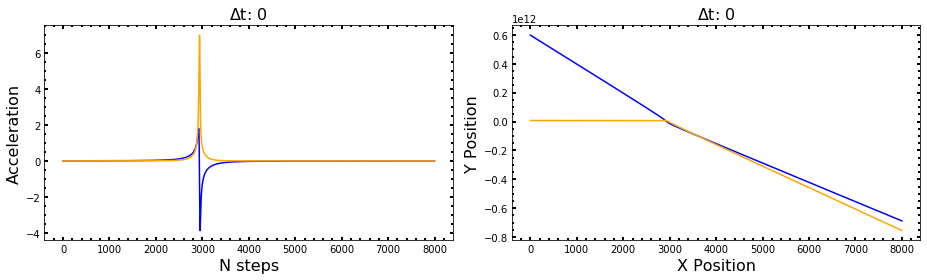

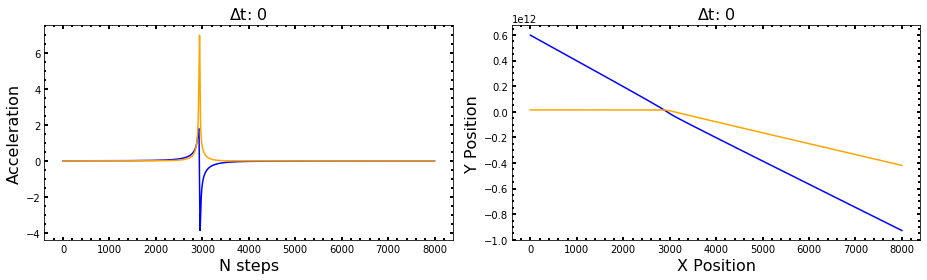

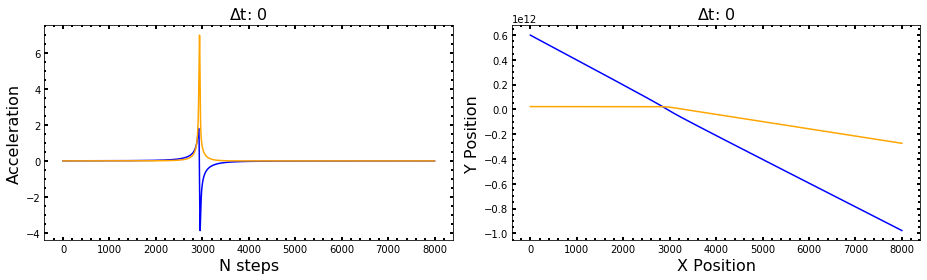

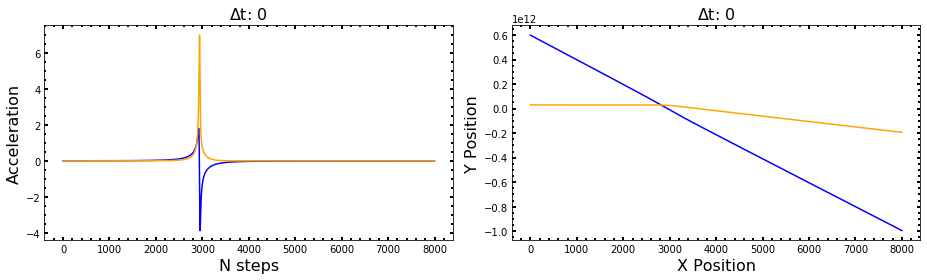

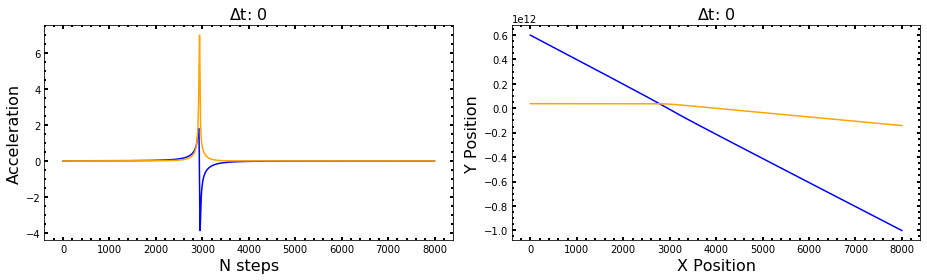

...

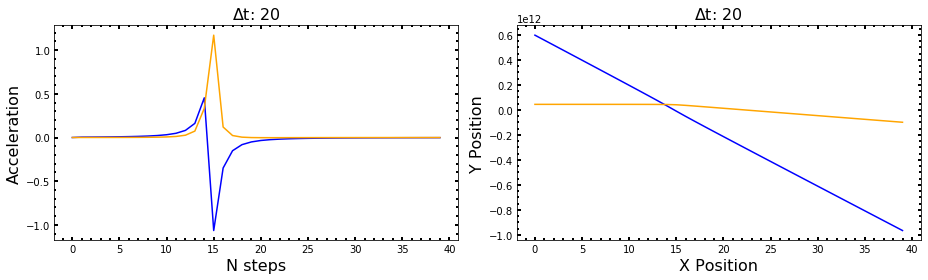

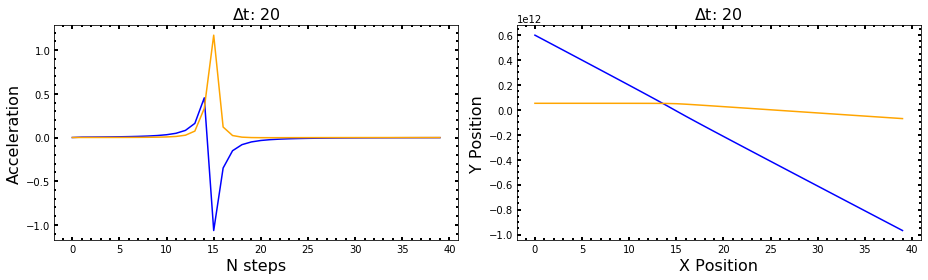

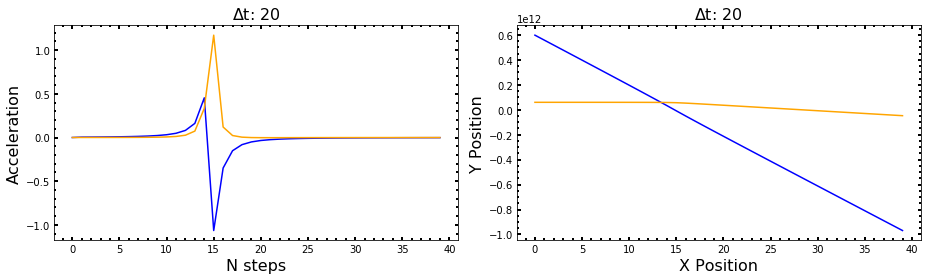

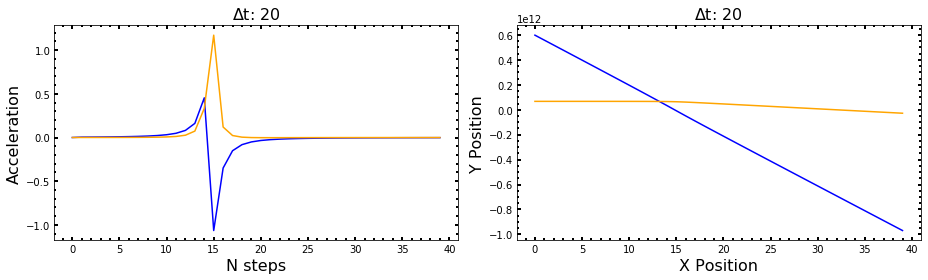

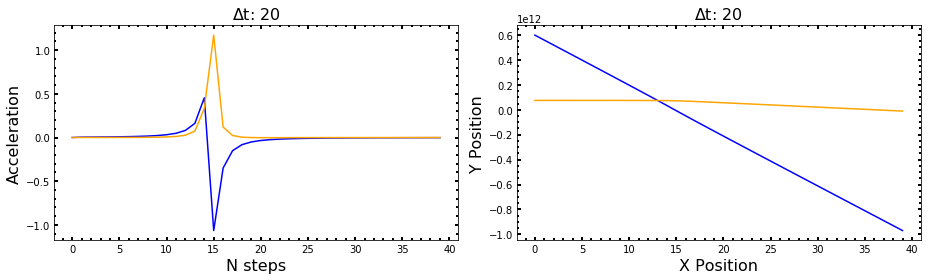

In [15]:
dts=np.linspace(0.1,20,40) #array of dts
time=800 #variable for how long the simulation will run for 
P=10

for i in range(len(dts)):
    Nsteps=time/dts[i]
    Nsteps=int(np.round(Nsteps))
    Xpos, Ypos, Xvel, Yvel, Xacc, Yacc, XaccB, YaccB = leapfrog(xi,ymax,vi,Nsteps,P,dts[i])
    for j in range(P):
        #xpos_e,ypos_e,xvel_e,yvel_e,xacc_e,yacc_e=euler(xi,ymax,vi,Nsteps,10,dts[i])
        #print(xpos)
        fig, ax = plt.subplots(1,2,figsize=[13,4])
        ax[0].plot(XaccB,color='blue', label='X-Acceleration')
        ax[0].plot(YaccB, color='orange',label='Y-Acceleration')
        ax[0].set_xlabel('N steps',fontsize=16)
        ax[0].set_ylabel('Acceleration',fontsize=16)
        ax[0].tick_params(which='both', direction='in',width=2)
        ax[0].yaxis.set_minor_locator(AutoMinorLocator())
        ax[0].xaxis.set_minor_locator(AutoMinorLocator())
        ax[0].yaxis.set_ticks_position('both')
        ax[0].xaxis.set_ticks_position('both')
        ax[0].set_title('$\Delta$t: {:d}'.
             format(int(np.round(dts[i]))),fontsize=16)
        

        ax[1].plot(Xpos[j],color='blue')
        ax[1].plot(Ypos[j],color='orange')
        ax[1].set_xlabel('X Position',fontsize=16)
        ax[1].set_ylabel('Y Position',fontsize=16)
        ax[1].tick_params(which='both', direction='in',width=2)
        ax[1].yaxis.set_minor_locator(AutoMinorLocator())
        ax[1].xaxis.set_minor_locator(AutoMinorLocator())
        ax[1].yaxis.set_ticks_position('both')
        ax[1].xaxis.set_ticks_position('both')
        ax[1].set_title('$\Delta$t: {:d}'.
             format(int(np.round(dts[i]))),fontsize=16)
        
        plt.subplots_adjust(wspace=0.9)
        plt.tight_layout()

      
        



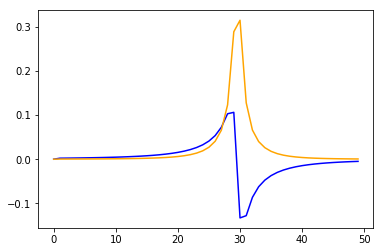

In [9]:
Xpos, Ypos, Xvel, Yvel, Xacc, Yacc, XaccB, YaccB = leapfrog(xi,ymax,vi,N,6,dt)
plt.plot(XaccB,color='blue')
plt.plot(YaccB,color='orange')


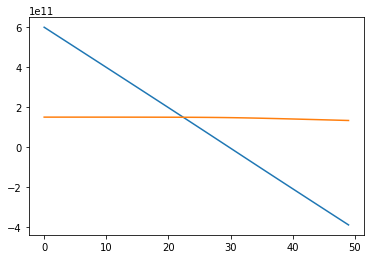

In [10]:
plt.plot(Xpos[5])
plt.plot(Ypos[5])

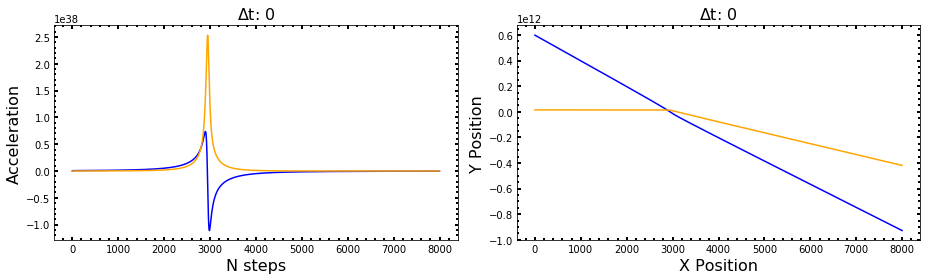

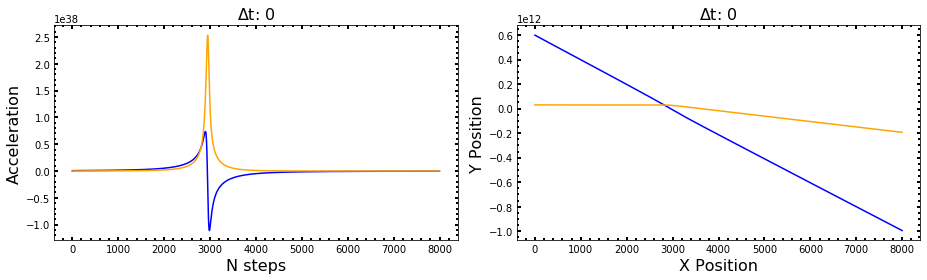

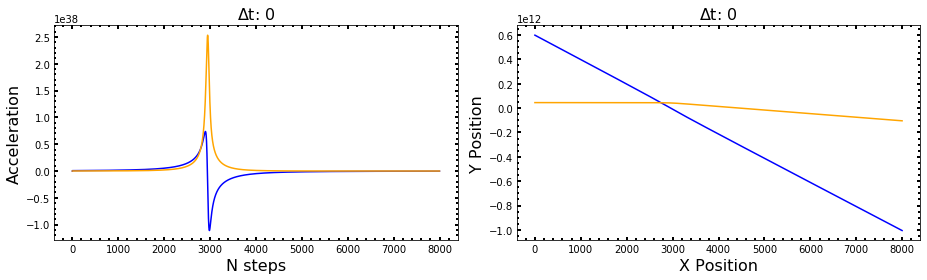

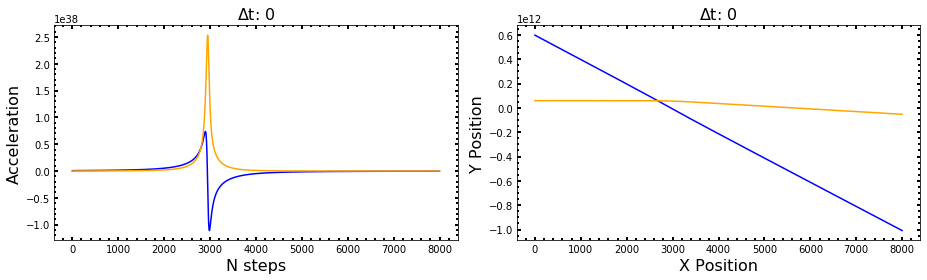

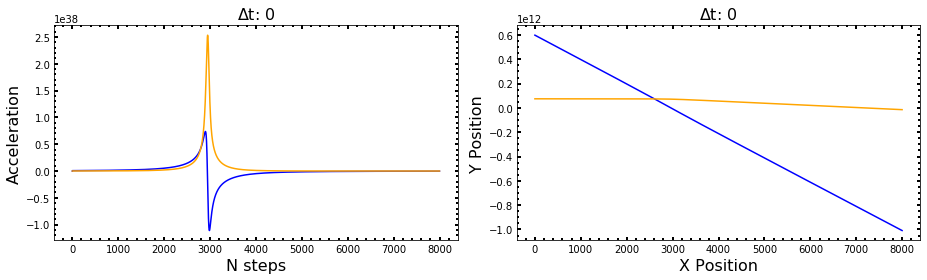

...

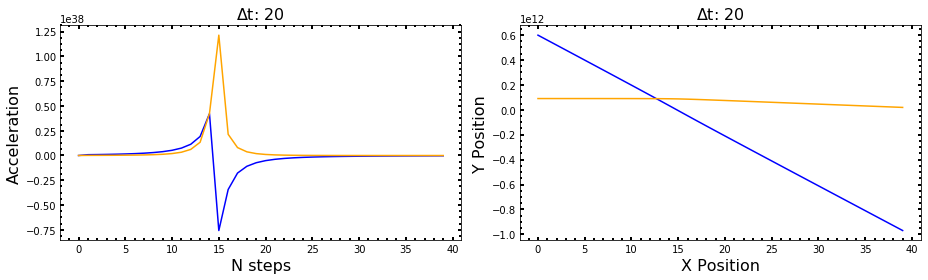

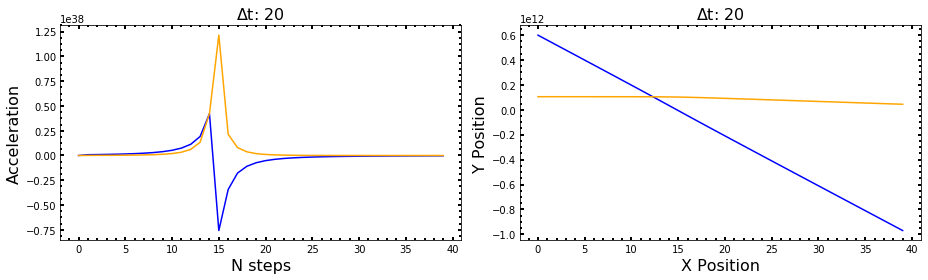

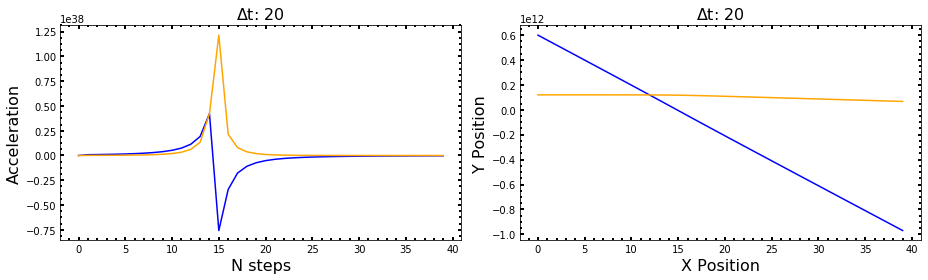

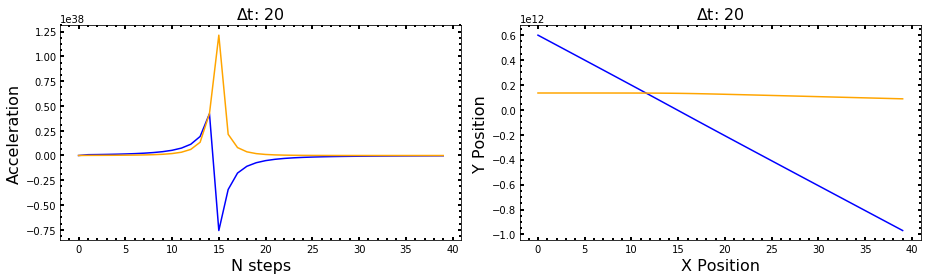

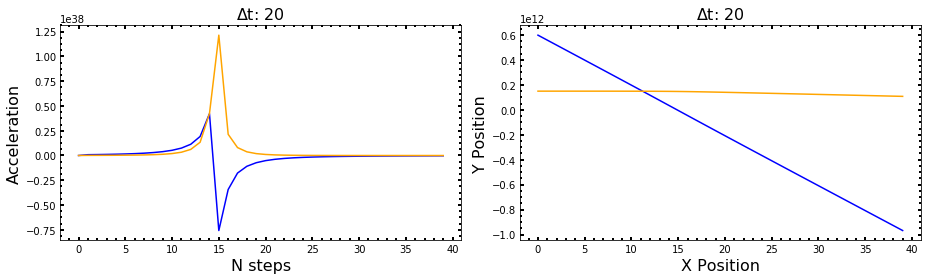

In [11]:
#Plotting the force on the massive object by multiplying by Big_M

dts=np.linspace(0.1,20,40) #array of dts
time=800 #variable for how long the simulation will run for 
P=10

for i in range(len(dts)):
    Nsteps=time/dts[i]
    Nsteps=int(np.round(Nsteps))
    Xpos, Ypos, Xvel, Yvel, Xacc, Yacc, XaccB, YaccB = leapfrog(xi,ymax,vi,Nsteps,P,dts[i])

    for j in range(P):
        
        #xpos_e,ypos_e,xvel_e,yvel_e,xacc_e,yacc_e=euler(xi,ymax,vi,Nsteps,10,dts[i])
        #print(xpos)
        fig, ax = plt.subplots(1,2,figsize=[13,4])
        ax[0].plot((XaccB*Big_M),color='blue', label='X-Acceleration')
        ax[0].plot((YaccB*Big_M), color='orange',label='Y-Acceleration')
        ax[0].set_xlabel('N steps',fontsize=16)
        ax[0].set_ylabel('Acceleration',fontsize=16)
        ax[0].tick_params(which='both', direction='in',width=2)
        ax[0].yaxis.set_minor_locator(AutoMinorLocator())
        ax[0].xaxis.set_minor_locator(AutoMinorLocator())
        ax[0].yaxis.set_ticks_position('both')
        ax[0].xaxis.set_ticks_position('both')
        ax[0].set_title('$\Delta$t: {:d}'.
             format(int(np.round(dts[i]))),fontsize=16)
        

        ax[1].plot(Xpos[j].T,color='blue')
        ax[1].plot(Ypos[j].T,color='orange')
        ax[1].set_xlabel('X Position',fontsize=16)
        ax[1].set_ylabel('Y Position',fontsize=16)
        ax[1].tick_params(which='both', direction='in',width=2)
        ax[1].yaxis.set_minor_locator(AutoMinorLocator())
        ax[1].xaxis.set_minor_locator(AutoMinorLocator())
        ax[1].yaxis.set_ticks_position('both')
        ax[1].xaxis.set_ticks_position('both')
        ax[1].set_title('$\Delta$t: {:d}'.
             format(int(np.round(dts[i]))),fontsize=16)
        
        plt.subplots_adjust(wspace=0.9)
        plt.tight_layout()

      
        



In [7]:
#Leapfrog for 10 particle DUPLICATE not using second for loop and using a functio for the entire calculation.
#For calculation of positions, velocities, and accelerations of the smaller mass particles. 
def leapfrog(xi,ymax,vi,N,P,dt):

    x = np.ones(P)*xi
    y = np.linspace(0,1,int(P)+1)[1:]*(ymax)
    vx = np.ones(P)*(-vi)
    vy = np.zeros(P)


    Xpos=np.zeros((P,N))
    Ypos=np.zeros((P,N))
    Xvel=np.zeros((P,N))
    Yvel=np.zeros((P,N))
    Xacc=np.zeros((P,N))
    Yacc=np.zeros((P,N))

    Xpos[:,0]=x
    Ypos[:,0]=y
    Xvel[:,0]=vx
    Yvel[:,0]=vy
    Xacc[:,0]=((-const.G.value*Big_M/((Xpos[:,0]**2+Ypos[:,0]**2)**(3/2)))*Xpos[:,0])
    Yacc[:,0]=((-const.G.value*Big_M/((Xpos[:,0]**2+Ypos[:,0]**2)**(3/2)))*Ypos[:,0])
    for i in range(N-1):
        #for j in range(p):

        Xpos[:,i+1] = Position(Xpos[:,i],Xvel[:,i],Xacc[:,i],dt)
            #Xpos[j,i+1] = Xpos[j,i] + Xvel[j,i] *dt + 0.5*(Xacc[j,i])*dt**2 
        Ypos[:,i+1] = Position(Ypos[:,i],Yvel[:,i],Yacc[:,i],dt) 

            #print(Xpos) #The x pos at this point is giving iterating up to N=1

        AccB=Acceleration_B
        Acc=Acceleration(Xpos[:,i+1],Ypos[:,i+1]) 
        Xacc[:,i+1] = Acc*Xpos[:,i+1]
        Yacc[:,i+1] = Acc*Ypos[:,i+1]

        Xvel[:,i+1] = Velocity(Xvel[:,i],Xacc[:,i],Xacc[:,i+1],dt)
        Yvel[:,i+1] = Velocity(Yvel[:,i],Yacc[:,i],Yacc[:,i+1],dt)
            #we can do vels for every particle at one time
        
    return Xpos, Ypos, Xvel, Yvel, Xacc, Yacc
    


In [8]:
#defining velocity and position functions that will be used in the euler function below
def vel(vx,x_acc,dt):
    vx=vx+x_acc*dt
    return vx

def pos(x,vx,dt):
    x=x+vx*dt
    return x


#Rewriting Euler integration in a function format and using array operations in one for loop

def euler(xi,ymax,vi,N,P,dt):
    vy = np.zeros(P)
    vx = np.ones(P)*(-vi)
    y=np.linspace(0,1,int(P)+1)[1:]*(ymax)
    x = np.ones(P)*xi

    Time_e = np.zeros((P,N))     
    Xpos_e = np.zeros((P,N))
    Ypos_e = np.zeros((P,N))
    Yvel_e = np.zeros((P,N))
    Xvel_e = np.zeros((P,N))
    Xacc_e=np.zeros((P,N))
    Yacc_e=np.zeros((P,N))

    Xpos_e[:,0]=x
    Ypos_e[:,0]=y
    Xvel_e[:,0]=vx
    Yvel_e[:,0]=vy
    Xacc_e[:,0]=((-const.G.value*Big_M/((Xpos_e[:,0]**2+Ypos_e[:,0]**2)**(3/2)))*Xpos_e[:,0])
    Yacc_e[:,0]=((-const.G.value*Big_M/((Xpos_e[:,0]**2+Ypos_e[:,0]**2)**(3/2)))*Ypos_e[:,0])

    for i in range(N-1): #Avoid square arrays!!!
        #print("i=", i)
        Xacc_e[:,i+1] = Acceleration(Xpos_e[:,i],Ypos_e[:,i])*Xpos_e[:,i]
        Yacc_e[:,i+1] = Acceleration(Xpos_e[:,i],Ypos_e[:,i])*Ypos_e[:,i]
        Xvel_e[:,i+1] = vel(Xvel_e[:,i],Xacc_e[:,i],dt)
        Yvel_e[:,i+1] = vel(Yvel_e[:,i],Yacc_e[:,i],dt)
        Xpos_e[:,i+1] = pos(Xpos_e[:,i],Xvel_e[:,i],dt)
        Ypos_e[:,i+1] = pos(Ypos_e[:,i],Yvel_e[:,i],dt)

    return Xpos_e,Ypos_e,Xvel_e,Yvel_e,Xacc_e,Yacc_e


In [9]:
Xpos, Ypos, Xvel, Yvel, Xacc, Yacc = leapfrog(xi,ymax,vi,100,6,10)
Xpos_e,Ypos_e,Xvel_e,Yvel_e,Xacc_e,Yacc_e = euler(xi,ymax,vi,100,6,10)


In [10]:
(Force(Xpos, Ypos))

array([[-3.63228595e+22, -4.63038015e+22, -6.02989077e+22,
        -8.05439840e+22, -1.10949156e+23, -1.58760850e+23,
        -2.38404139e+23, -3.81314226e+23, -6.64595726e+23,
        -1.31046455e+24, -3.12709583e+24, -1.03278488e+25,
        -6.05991722e+25, -1.95265284e+26, -2.92118539e+25,
        -6.34242948e+24, -2.21315007e+24, -1.00555615e+24,
        -5.36661591e+23, -3.18840966e+23, -2.04446290e+23,
        -1.38775377e+23, -9.84440010e+22, -7.23297030e+22,
        -5.46858898e+22, -4.23407958e+22, -3.34467482e+22,
        -2.68779506e+22, -2.19218850e+22, -1.81126737e+22,
        -1.51369864e+22, -1.27788227e+22, -1.08859984e+22,
        -9.34919454e+21, -8.08851029e+21, -7.04462827e+21,
        -6.17288565e+21, -5.43921911e+21, -4.81734289e+21,
        -4.28675373e+21, -3.83129972e+21, -3.43814010e+21,
        -3.09697973e+21, -2.79949930e+21, -2.53892677e+21,
        -2.30971181e+21, -2.10727624e+21, -1.92782105e+21,
        -1.76817595e+21, -1.62568134e+21, -1.49809477e+2

In [36]:
np.sum(Force(Xpos,Ypos)[0])+np.sum(Force(Xpos,Ypos)[1])+np.sum(Force(Xpos,Ypos)[2])+np.sum(Force(Xpos,Ypos)[3])+np.sum(Force(Xpos,Ypos)[4])+np.sum(Force(Xpos,Ypos)[5])

-4.612684011969279e+26

In [37]:
np.sum(Force(Xpos,Ypos))

-4.612684011969279e+26

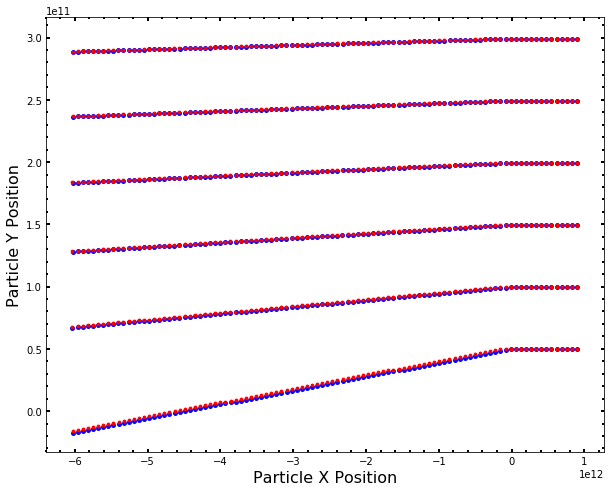

In [16]:
fig, ax = plt.subplots(figsize=[10,8])
ax.scatter(Xpos,Ypos,color='blue',s=15,label='leapfrog')
ax.scatter(Xpos_e,Ypos_e,color='red',s=8,label='Euler')
ax.set_xlabel('Particle X Position',fontsize=16)
ax.set_ylabel('Particle Y Position',fontsize=16)
ax.tick_params(which='both', direction='in',width=2)
ax.yaxis.set_ticks_position('both')
ax.xaxis.set_ticks_position('both')
ax.yaxis.set_minor_locator(AutoMinorLocator())
ax.xaxis.set_minor_locator(AutoMinorLocator());